# NLP Project Part 2 


# Clustring

 
In this section we try to cluster data and see the result if there is cluster of positive , negative , neutre sentences or non . I think No this kind of stuff need to be supervised but let try :    ▶ 


In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score 
import matplotlib.pyplot as plt

## Let check how many cluster we need  : 

In [ ]:
inertias = [] # our WSS
ks = range(1, 10)
# Creating 10 K-Mean++ models while varying the number of clusters (k)
for k in range(1,10):
    model = KMeans (n_clusters = k ,init = 'k-means++')
    
    # Fit model to samples
    model.fit(avg_vecs)
    
    # Append the inertia to the list of inertias
    inertias.append(model.inertia_)

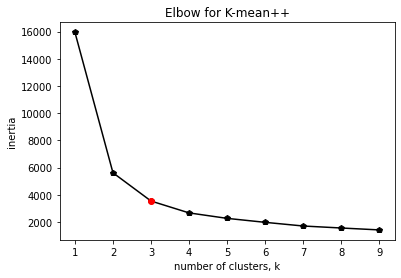

In [ ]:
plt.plot(range(1,10), inertias, '-p', color='black')
plt.xlabel('number of clusters, k')
plt.ylabel('inertia')
plt.plot(3,inertias[2],'ro')
plt.xticks(ks)
plt.title('Elbow for K-mean++')
plt.show() 

  Yes , that was expected Three Cluster  ✅

### we try to cluster data  and do a Nice vizualisation : 

In [ ]:
data_set=pd.read_csv('data.csv') 

In [ ]:
data_set.drop(to_del)  

,Sentence,Sentiment
0,The GeoSolutions technology will leverage Bene...,positive
1,"$ESI on lows, down $1.50 to $2.50 BK a real po...",negative
2,"For the last quarter of 2010 , Componenta 's n...",positive
3,According to the Finnish-Russian Chamber of Co...,neutral
4,The Swedish buyout firm has sold its remaining...,neutral
...,...,...
5837,RISING costs have forced packaging producer Hu...,negative
5838,Nordic Walking was first used as a summer trai...,neutral
5839,"According shipping company Viking Line , the E...",neutral
5840,"In the building and home improvement trade , s...",neutral


In [ ]:
data=pd.DataFrame(avg_vecs)

 We make a averge vectors in the same row with the sentences : 

In [ ]:
df=pd.merge(data_set, data, left_index=True, right_index=True) ## We make a averge vectors in the same row with the sentences  

In [ ]:
df 


,Sentence,Sentiment,0,1,2,3,4,5,6,7,...,190,191,192,193,194,195,196,197,198,199
0,The GeoSolutions technology will leverage Bene...,positive,-0.007924,-0.223087,0.053513,-0.092287,0.186106,-0.143922,-0.302044,0.109837,...,-0.033534,-0.125585,0.200090,-0.013439,0.066113,0.089940,0.098243,-0.173657,-0.023096,-0.217823
1,"$ESI on lows, down $1.50 to $2.50 BK a real po...",negative,-0.033407,-0.185608,-0.139528,0.187546,0.125491,-0.186068,0.108543,0.425107,...,0.044660,-0.114231,0.106686,-0.050289,0.072860,-0.021438,0.026665,-0.150976,0.046502,-0.203028
2,"For the last quarter of 2010 , Componenta 's n...",positive,0.125046,0.056649,-0.220464,0.496381,0.126217,-0.286173,0.592212,0.714471,...,0.326551,-0.209325,-0.442689,-0.256762,0.310491,0.020907,0.157587,-0.183014,-0.015510,-0.124678
3,According to the Finnish-Russian Chamber of Co...,neutral,0.003853,-0.171919,0.011540,0.036366,0.172062,-0.160615,-0.117759,0.222415,...,0.044890,-0.146413,0.079376,-0.080953,0.115625,0.044681,0.110950,-0.165525,-0.010940,-0.183199
4,The Swedish buyout firm has sold its remaining...,neutral,0.024353,-0.102986,-0.071792,0.106625,0.153534,-0.182802,0.021705,0.330730,...,0.084876,-0.143799,-0.000739,-0.076875,0.111007,0.051909,0.072806,-0.160228,-0.009412,-0.167364
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5803,Clothing chain Sepp+ñl+ñ 's net sales increase...,positive,0.014964,-0.123877,-0.011971,-0.002653,0.151584,-0.148771,-0.136416,0.191442,...,0.037576,-0.106276,0.076302,-0.042566,0.076620,0.080352,0.100525,-0.170094,-0.012681,-0.175547
5804,The administrators have indicated a need for 9...,negative,0.009051,-0.120605,-0.027529,0.019491,0.144585,-0.134330,-0.100360,0.208948,...,0.049316,-0.107199,0.074076,-0.034060,0.070594,0.071173,0.084963,-0.170542,-0.005605,-0.166664
5805,"The new office , located in Shenzhen , will st...",positive,0.015072,-0.102433,-0.023300,0.035408,0.145768,-0.153834,-0.076065,0.228040,...,0.059994,-0.120730,0.038342,-0.057840,0.096389,0.069993,0.097647,-0.167855,-0.012384,-0.168423
5806,"However , the total orders received will still...",positive,0.091973,0.042430,-0.168200,0.359545,0.153028,-0.240070,0.363694,0.629277,...,0.313023,-0.168646,-0.320361,-0.212850,0.263384,0.111964,0.193941,-0.328517,-0.024283,-0.208992


### We cluster Now ☄ :

In [ ]:
X=df.drop(columns=['Sentence' , 'Sentiment'])    

In [ ]:
X

,0,1,2,3,4,5,6,7,8,9,...,190,191,192,193,194,195,196,197,198,199
0,-0.007924,-0.223087,0.053513,-0.092287,0.186106,-0.143922,-0.302044,0.109837,0.044898,0.341305,...,-0.033534,-0.125585,0.200090,-0.013439,0.066113,0.089940,0.098243,-0.173657,-0.023096,-0.217823
1,-0.033407,-0.185608,-0.139528,0.187546,0.125491,-0.186068,0.108543,0.425107,-0.084094,0.152714,...,0.044660,-0.114231,0.106686,-0.050289,0.072860,-0.021438,0.026665,-0.150976,0.046502,-0.203028
2,0.125046,0.056649,-0.220464,0.496381,0.126217,-0.286173,0.592212,0.714471,-0.383984,-0.069170,...,0.326551,-0.209325,-0.442689,-0.256762,0.310491,0.020907,0.157587,-0.183014,-0.015510,-0.124678
3,0.003853,-0.171919,0.011540,0.036366,0.172062,-0.160615,-0.117759,0.222415,-0.040032,0.246415,...,0.044890,-0.146413,0.079376,-0.080953,0.115625,0.044681,0.110950,-0.165525,-0.010940,-0.183199
4,0.024353,-0.102986,-0.071792,0.106625,0.153534,-0.182802,0.021705,0.330730,-0.078210,0.163306,...,0.084876,-0.143799,-0.000739,-0.076875,0.111007,0.051909,0.072806,-0.160228,-0.009412,-0.167364
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5803,0.014964,-0.123877,-0.011971,-0.002653,0.151584,-0.148771,-0.136416,0.191442,-0.020190,0.225283,...,0.037576,-0.106276,0.076302,-0.042566,0.076620,0.080352,0.100525,-0.170094,-0.012681,-0.175547
5804,0.009051,-0.120605,-0.027529,0.019491,0.144585,-0.134330,-0.100360,0.208948,-0.025042,0.204545,...,0.049316,-0.107199,0.074076,-0.034060,0.070594,0.071173,0.084963,-0.170542,-0.005605,-0.166664
5805,0.015072,-0.102433,-0.023300,0.035408,0.145768,-0.153834,-0.076065,0.228040,-0.045848,0.189398,...,0.059994,-0.120730,0.038342,-0.057840,0.096389,0.069993,0.097647,-0.167855,-0.012384,-0.168423
5806,0.091973,0.042430,-0.168200,0.359545,0.153028,-0.240070,0.363694,0.629277,-0.296727,0.043329,...,0.313023,-0.168646,-0.320361,-0.212850,0.263384,0.111964,0.193941,-0.328517,-0.024283,-0.208992


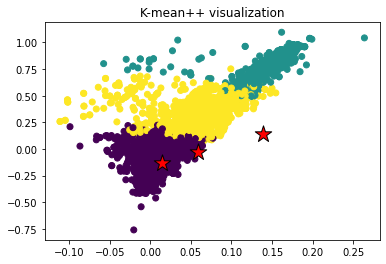

In [ ]:
model = KMeans(n_clusters=3, init = 'k-means++', n_init = 5) 
model.fit(X)

# coordinates of cluster center
centroids = model.cluster_centers_ 

# cluster label for each data point
labels = model.labels_ 

plt.scatter(X[0], X[6], c=labels)
plt.scatter( centroids[:, 0], centroids[:, 1], s=300, marker='*', c='red', edgecolor='black')
plt.title('K-mean++ visualization')
plt.show()





### Yes we have Nice three Cluster , But we need to nice Viz Altair is the best for this task 🇺 

In [ ]:
labels=pd.DataFrame(labels)   

In [ ]:
labels.columns = ['labels']   
 


In [ ]:
df=pd.merge(df, labels, left_index=True, right_index=True)  

In [ ]:
!pip install altair

In [ ]:
import altair as alt  

In [ ]:
df.columns = df.columns.map(str)

In [ ]:
df1=df[:3500]  ### Altair have problem with more then 5000 raws 
 

In [ ]:
chart=alt.Chart(df1).mark_point().encode(
    x='12', ## the elemnts of vector
    y='1', ## the elements of vectors 
    color='labels',
    tooltip=['Sentence', 'Sentiment'] 
)

In [ ]:
chart

alt.Chart(...)

In this case : the clustring take a count of all words so the cluster maded by sentence similarty in many dimension. So we can't have a cluster just with positive sentences it logic but we can see some similarty : for example the cluster of left-down the sentences has macro-economic information  , and sentences in the right-up the sentences have micro-economic information  . 
And between is combination between macro and micro information.  

# Random forest : Prediction sentiment  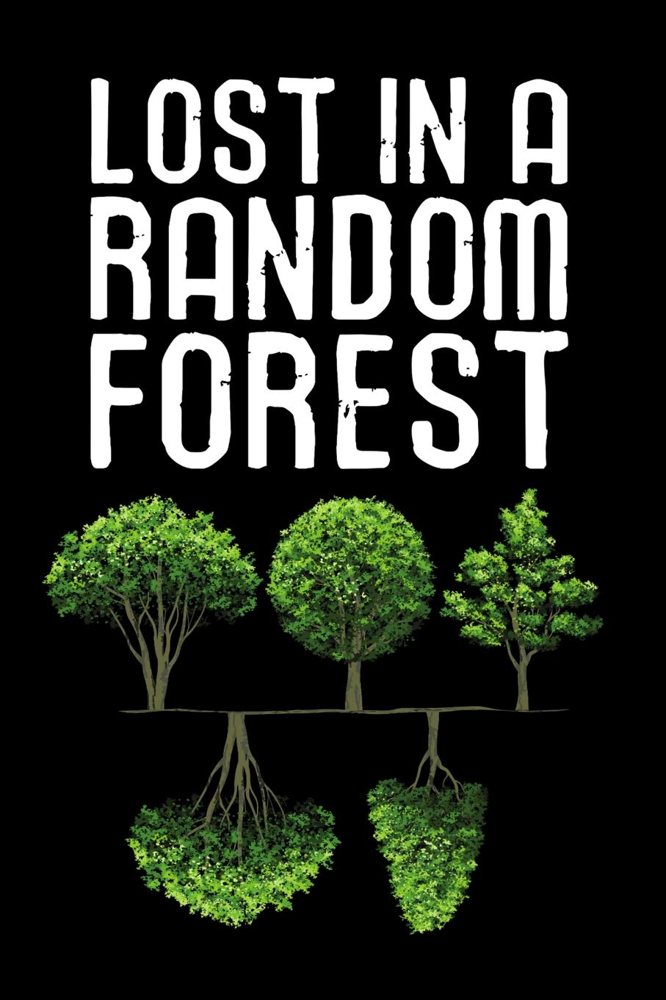


In [ ]:
from sklearn.model_selection import train_test_split   
from sklearn.ensemble import RandomForestClassifier   
from sklearn.metrics import accuracy_score


## Our Data set is not balanced so we have to balance it:
 

In [ ]:
df_neut = df[df['Sentiment']=='neutral']  
df_positve=df[df['Sentiment']=='positive'] 
df_positve=df_positve.sample(1000) 
df_negative=df[df['Sentiment']=='negative'] 
df_neut=df_neut.sample(1000)   

In [ ]:
 df1=pd.concat([df_neut,df_positve,df_negative]) 

In [ ]:
X1=df1.drop(columns=['Sentence','Sentiment','labels'])   
Y1=df1['Sentiment']  

## We estimate a modell : ⛰ : 

In [ ]:
Xtrain,Xtest,ytrain,ytest = train_test_split(X1,Y1, test_size = 0.2, random_state = 42)

In [ ]:
clf = RandomForestClassifier(max_depth=2, random_state=0)
model=clf.fit(Xtrain, ytrain)

In [ ]:
ypred=model.predict(Xtest) 

In [ ]:
print('Model accuracy score with 10 decision-trees : {0:0.4f}'. format(accuracy_score(ytest, ypred))) 

Model accuracy score with 10 decision-trees : 0.3579


So pooor accuracy because :  

1.   We have more than Three class. 
2.   the Avg vectors don't work well with estimations 



# DEEP Learning 
 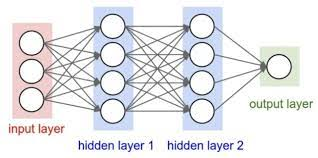

WE Import tools that will need. : 

In [ ]:
#For strings 
import re  
import collections
import matplotlib.pyplot as plt# for plot 
#FOR ESTIMATION 
from sklearn.model_selection import train_test_split
from nltk.corpus import stopwords
from keras.preprocessing.text import Tokenizer # for input tokenzer 
from keras.utils.np_utils import to_categorical
from sklearn.preprocessing import LabelEncoder #for output code 

from keras import models
from keras import layers
from keras import regularizers

In [ ]:
NB_WORDS = 10000 ##
VAL_SIZE = 200
NB_START_EPOCHS = 25
BATCH_SIZE = 522

In [ ]:
X11=df['Sentence']   
y11=df['Sentiment']


In [ ]:
def remove_stopwords(input_text):
        stopwords_list = stopwords.words('english')
        # Some words which might indicate a certain sentiment are kept via a whitelist
        whitelist = ["n't", "not", "no"]
        words = input_text.split() 
        clean_words = [word for word in words if (word not in stopwords_list or word in whitelist) and len(word) > 1] 
        return " ".join(clean_words) 

In [ ]:
def remove_mentions(input_text):
        return re.sub(r'@\w+', '', input_text) 

In [ ]:
X11 = X11.apply(remove_stopwords).apply(remove_mentions)  

In [ ]:
X11[0:3]

0    The GeoSolutions technology leverage Benefon '...
1           $ESI lows, $1.50 $2.50 BK real possibility
2    For last quarter 2010 Componenta 's net sales ...
Name: Sentence, dtype: object

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X11, y11, test_size=0.1, random_state=37)  

In [ ]:
tk = Tokenizer(num_words=NB_WORDS,
               filters='!"#$%&()*+,-./:;<=>?@[\\]^_`{|}~\t\n',
               lower=True,
               split=" ") 

In [ ]:
X_train_seq = tk.texts_to_sequences(X_train)
X_test_seq = tk.texts_to_sequences(X_test)

print('"{}" is converted into {}'.format(X_train[0], X_train_seq[0])) 

"The GeoSolutions technology leverage Benefon 's GPS solutions providing Location Based Search Technology Communities Platform location relevant multimedia content new powerful commercial model" is converted into [1, 1805, 77, 176, 45, 2386, 3676, 443, 86, 162, 5383, 45]


In [ ]:
def one_hot_seq(seqs, nb_features = NB_WORDS): ## to resume the information 
    ohs = np.zeros((len(seqs), nb_features))
    for i, s in enumerate(seqs):
        ohs[i, s] = 1.
    return ohs

In [ ]:
X_train_oh = one_hot_seq(X_train_seq)
X_test_oh = one_hot_seq(X_test_seq) 

le = LabelEncoder()
y_train_le = le.fit_transform(y_train)
y_test_le = le.transform(y_test)
y_train_oh = to_categorical(y_train_le)
y_test_oh = to_categorical(y_test_le)

print('"{}" is converted into {}'.format(y_train[0], y_train_le[0]))
print('"{}" is converted into {}'.format(y_train_le[0], y_train_oh[0])) 

"positive" is converted into 1
"1" is converted into [0. 1. 0.]


In [ ]:
X_train_rest, X_valid, y_train_rest, y_valid = train_test_split(X_train_oh, y_train_oh, test_size=0.1, random_state=37)

assert X_valid.shape[0] == y_valid.shape[0]
assert X_train_rest.shape[0] == y_train_rest.shape[0]

print('Shape of validation set:',X_valid.shape)

Shape of validation set: (523, 10000)


In [ ]:
base_model = models.Sequential()
base_model.add(layers.Dense(64, activation='relu', input_shape=(NB_WORDS,))) 
base_model.add(layers.Dropout(0.5))
base_model.add(layers.Dense(64, activation='relu')) 
base_model.add(layers.Dropout(0.7)) 
base_model.add(layers.Dense(32, activation='relu')) 
base_model.add(layers.Dropout(0.5)) 
base_model.add(layers.Dense(3, activation='softmax'))
base_model.summary() 

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_9 (Dense)             (None, 64)                640064    
                                                                 
 dropout_3 (Dropout)         (None, 64)                0         
                                                                 
 dense_10 (Dense)            (None, 64)                4160      
                                                                 
 dropout_4 (Dropout)         (None, 64)                0         
                                                                 
 dense_11 (Dense)            (None, 32)                2080      
                                                                 
 dropout_5 (Dropout)         (None, 32)                0         
                                                                 
 dense_12 (Dense)            (None, 3)                

In [ ]:
def deep_model(model):
    model.compile(optimizer='rmsprop'
                  , loss='categorical_crossentropy'
                  , metrics=['accuracy'])
    
    history = model.fit(X_train_rest
                       , y_train_rest
                       , epochs=NB_START_EPOCHS
                       , batch_size=BATCH_SIZE
                       , validation_data=(X_valid, y_valid)
                       , verbose=0)
    
    return history

In [ ]:
base_history = deep_model(base_model) 
def eval_metric(history, metric_name):
    metric = history.history[metric_name]
    val_metric = history.history['val_' + metric_name]

    e = range(1, NB_START_EPOCHS + 1)

    plt.plot(e, metric, 'bo', label='Train ' + metric_name)
    plt.plot(e, val_metric, 'b', label='Validation ' + metric_name)
    plt.legend()
    plt.show()

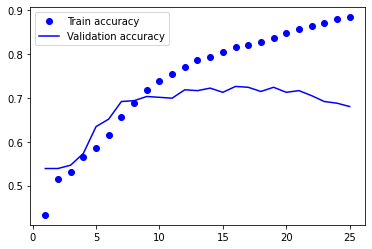

In [ ]:
eval_metric(base_history, 'accuracy') 